In [26]:
# For Python2.6 compatibility
from __future__ import print_function

import pretty_midi
import numpy as np
# For plotting
import mir_eval.display
import librosa.display
import matplotlib.pyplot as plt
%matplotlib inline
# For putting audio in the notebook
import IPython.display

In [27]:
import pretty_midi
# For putting audio in the notebook
import IPython.display
# Create a PrettyMIDI object
cello_c_chord = pretty_midi.PrettyMIDI()
# Create an Instrument instance for a cello instrument
cello_program = pretty_midi.instrument_name_to_program('Cello')
cello = pretty_midi.Instrument(program=cello_program)
# Iterate over note names, which will be converted to note number later
for note_name in ['C5', 'E5', 'G5']:
    # Retrieve the MIDI note number for this note name
    note_number = pretty_midi.note_name_to_number(note_name)
    # Create a Note instance, starting at 0s and ending at .5s
    note = pretty_midi.Note(
        velocity=100, pitch=note_number, start=0, end=2)
    # Add it to our cello instrument
    cello.notes.append(note)
# Add the cello instrument to the PrettyMIDI object
cello_c_chord.instruments.append(cello)
# Write out the MIDI data
cello_c_chord.write('cello-C-chord.mid')

In [28]:
IPython.display.Audio(cello_c_chord.synthesize(fs=16000),rate=16000)

In [29]:
midi_data = pretty_midi.PrettyMIDI('teddybear.mid')

In [30]:
print (midi_data.estimate_tempo())

157.62029746281715


In [31]:
# The instruments list from our PrettyMIDI instance starts empty
print(midi_data .instruments)

[Instrument(program=1, is_drum=False, name="Piano"), Instrument(program=1, is_drum=False, name="Base")]


In [32]:
IPython.display.Audio(midi_data.synthesize(fs=16000),rate=16000)

In [33]:
midi_data.write('out1.mid')

In [34]:
print('There are {} time signature changes'.format(len(midi_data.time_signature_changes)))
print('There are {} instruments'.format(len(midi_data.instruments)))

There are 1 time signature changes
There are 2 instruments


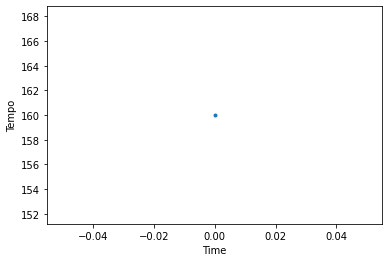

In [35]:
# Plot the tempo changes over time
# Many MIDI files won't have more than one tempo change event,
# but this particular file was transcribed to somewhat closely match the original song.
times, tempo_changes = midi_data.get_tempo_changes()
plt.plot(times, tempo_changes, '.')
plt.xlabel('Time')
plt.ylabel('Tempo');

In [36]:
tempo_changes

array([160.])

c:\users\gunjan singh\appdata\local\programs\python\python38\lib\site-packages\librosa\util\decorators.py:88: UserWarning: Frequency axis exceeds Nyquist. Did you remember to set all spectrogram parameters in specshow?
  return f(*args, **kwargs)


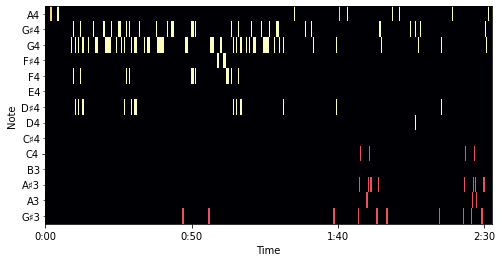

In [37]:
def plot_piano_roll(pm, start_pitch, end_pitch, fs=100):
    # Use librosa's specshow function for displaying the piano roll
    librosa.display.specshow(pm.get_piano_roll(fs)[start_pitch:end_pitch],
                             hop_length=1, sr=fs, x_axis='time', y_axis='cqt_note',
                             fmin=pretty_midi.note_number_to_hz(start_pitch))

plt.figure(figsize=(8, 4))
plot_piano_roll(midi_data, 56, 70)

In [38]:
IPython.display.Audio(midi_data.synthesize(fs=16000),rate=16000)

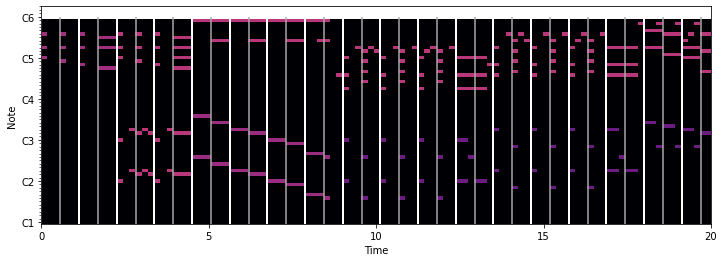

In [39]:
# Get beats and downbeat times
beats = midi_data.get_beats()
downbeats = midi_data.get_downbeats()
# Plot piano roll
plt.figure(figsize=(12, 4))
plot_piano_roll(midi_data, 24, 84)
ymin, ymax = plt.ylim()
# Plot beats as grey lines, downbeats as white lines
mir_eval.display.events(beats, base=ymin, height=ymax, color='#AAAAAA')
mir_eval.display.events(downbeats, base=ymin, height=ymax, color='#FFFFFF', lw=2)
# Only display 20 seconds for clarity
plt.xlim(0, 20);

In [40]:
beats

array([  0.    ,   0.5625,   1.125 ,   1.6875,   2.25  ,   2.8125,
         3.375 ,   3.9375,   4.5   ,   5.0625,   5.625 ,   6.1875,
         6.75  ,   7.3125,   7.875 ,   8.4375,   9.    ,   9.5625,
        10.125 ,  10.6875,  11.25  ,  11.8125,  12.375 ,  12.9375,
        13.5   ,  14.0625,  14.625 ,  15.1875,  15.75  ,  16.3125,
        16.875 ,  17.4375,  18.    ,  18.5625,  19.125 ,  19.6875,
        20.25  ,  20.8125,  21.375 ,  21.9375,  22.5   ,  23.0625,
        23.625 ,  24.1875,  24.75  ,  25.3125,  25.875 ,  26.4375,
        27.    ,  27.5625,  28.125 ,  28.6875,  29.25  ,  29.8125,
        30.375 ,  30.9375,  31.5   ,  32.0625,  32.625 ,  33.1875,
        33.75  ,  34.3125,  34.875 ,  35.4375,  36.    ,  36.5625,
        37.125 ,  37.6875,  38.25  ,  38.8125,  39.375 ,  39.9375,
        40.5   ,  41.0625,  41.625 ,  42.1875,  42.75  ,  43.3125,
        43.875 ,  44.4375,  45.    ,  45.5625,  46.125 ,  46.6875,
        47.25  ,  47.8125,  48.375 ,  48.9375,  49.5   ,  50.0

In [48]:
midi_data = pretty_midi.PrettyMIDI('Never-Gonna-Give-You-Up-3.mid')

In [49]:
IPython.display.Audio(midi_data.synthesize(fs=16000),rate=16000)

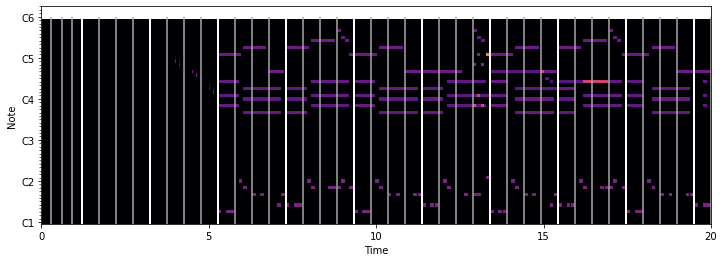

In [50]:
# Get beats and downbeat times
beats = midi_data.get_beats()
downbeats = midi_data.get_downbeats()
# Plot piano roll
plt.figure(figsize=(12, 4))
plot_piano_roll(midi_data, 24, 84)
ymin, ymax = plt.ylim()
# Plot beats as grey lines, downbeats as white lines
mir_eval.display.events(beats, base=ymin, height=ymax, color='#AAAAAA')
mir_eval.display.events(downbeats, base=ymin, height=ymax, color='#FFFFFF', lw=2)
# Only display 20 seconds for clarity
plt.xlim(0, 20);